# Recuperação de imagens com base no conteúdo visual utilizando BoVW

## Método Bag of Visual Words

O Bag of Visual Words (BoVW), ou “Saco de Palavras Visuais”, é uma técnica de visão computacional inspirada no “Bag of Words” usando e processamento de linguagem natural (NLP).

* Analogia com NLP:
    * Em NLP, um texto é representado como um **histograma de palavras**, ignorando a ordem das frases.
    * No BoVW, uma imagem é representada como um histograma de palavras visuais, ignorando a posição exata das características.
* Objetivo Principal:
    * Classificar imagens (ex.: reconhecer objetos, cenas) ou recuperar imagens similares em bancos de dados.


# Importando as bibliotecas

In [17]:
import re
import os
import glob
import cv2
import glob
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics.pairwise import cosine_similarity

In [ ]:
PATH_DIR = "../../data/coil-100"

images_path = sorted(glob.glob(f"{PATH_DIR}/*.png"))

images_name = [name.split('/')[-1] for name in images_path]

print(f"Total de {len(images_path)} imagens.")

Total de 7200 imagens.


In [34]:
objs = list(set([obj.split('_')[0] for obj in images_name]))
objs = sorted(objs, key=lambda x: int(re.search(r'\d+', x).group()))
print(f"Total de {len(objs)} objetos")

Total de 100 objetos


# Extração de Características com SIFT

In [40]:
# Caminho do diretório com imagens de referência
# image_dir = "coil-100/"

# Função para carregar e extrair descritores SIFT
def extract_descriptors(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(image, None)
    return descriptors

# Criar o banco de dados de descritores
# image_paths = glob.glob(os.path.join(image_dir, "*.png"))
descriptors_list = []
image_descriptors = {}

for i in range(len(images_path)):
    descriptors = extract_descriptors(images_path[i])
    if descriptors is not None:
        descriptors_list.extend(descriptors)
        image_descriptors[images_name[i]] = descriptors

In [41]:
len(image_descriptors), len(image_descriptors), len(images_path)

(7199, 7199, 7200)

In [42]:
len(descriptors_list)

343246

In [43]:
len(descriptors_list[0])

128

In [44]:
# Converter descritores para matriz numpy
descriptors_array = np.vstack(descriptors_list)
descriptors_array.shape

(343246, 128)

# Criação do Vocabulário Visual

In [45]:
# Número de clusters para o BoW
num_clusters = 80

# Criar dicionário visual com K-Means
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(descriptors_array)

KMeans(n_clusters=80, random_state=42)

# Representação das Imagens como Histogramas

In [47]:
# Criar histogramas de palavras visuais para cada imagem
def compute_histogram(descriptors, kmeans):
    labels = kmeans.predict(descriptors)
    histogram, _ = np.histogram(labels, bins=kmeans.n_clusters, range=(0, kmeans.n_clusters))
    return histogram / np.sum(histogram)

image_histograms = {}
for img_path, descriptors in image_descriptors.items():
    image_histograms[img_path] = compute_histogram(descriptors, kmeans)

In [57]:
# Calcular a similaridade entre a imagem de consulta e as imagens do banco de dados
def compute_similarity(hist1, hist2):
    return cosine_similarity([hist1], [hist2])[0][0]

def plot_consulta(query_image_path, sorted_images, similarities,
                  total_images, figsize=(10, 5)):

    # Exibir os resultados
    query_image = cv2.imread(query_image_path, cv2.IMREAD_COLOR)
    plt.figure(figsize=figsize)
    plt.subplot(1, len(sorted_images[:total_images]) + 1, 1)
    plt.imshow(cv2.cvtColor(query_image, cv2.COLOR_BGR2RGB))
    plt.title("Consulta")
    plt.axis("off")

    for i, img_path in enumerate(sorted_images[:total_images]):
        img = cv2.imread(f"{PATH_DIR}/{img_path}", cv2.IMREAD_COLOR)
        plt.subplot(1, len(sorted_images[:total_images]) + 1, i + 2)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f"Sim: {similarities[img_path]:.2f}")
        plt.axis("off")

    plt.show()

In [52]:
def consulta(obj, total_consultas=5, figsize=(10, 5)):
    query = list(filter(lambda x: x.startswith(obj+'_'), images_name))[0]
    query_image_path = f"{PATH_DIR}/{query}"

    # Processar a imagem de consulta
    query_descriptors = extract_descriptors(query_image_path)
    query_histogram = compute_histogram(query_descriptors, kmeans)

    similarities = {
        img_path: compute_similarity(query_histogram, hist)
        for img_path, hist in image_histograms.items()
    }

    # Ordena do maior para o menor (similaridade do cosseno)
    sorted_images = sorted(similarities, key=similarities.get, reverse=True)

    plot_consulta(query_image_path, sorted_images,
                  total_images=total_consultas,
                  similarities=similarities,
                  figsize=figsize)

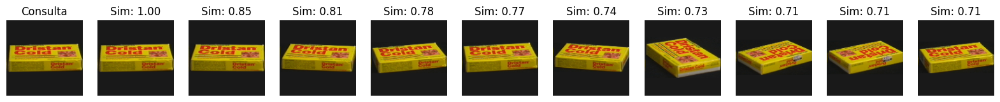

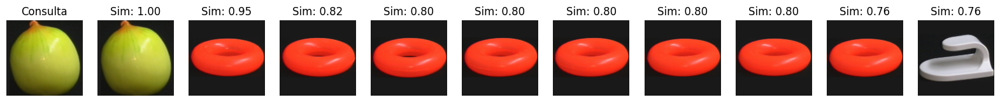

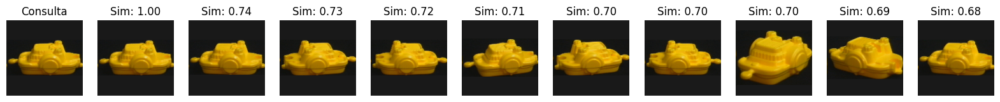

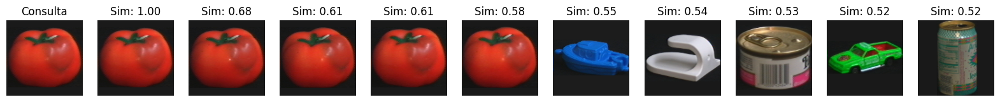

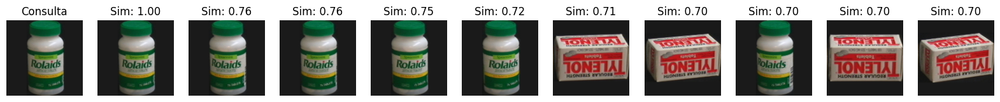

...

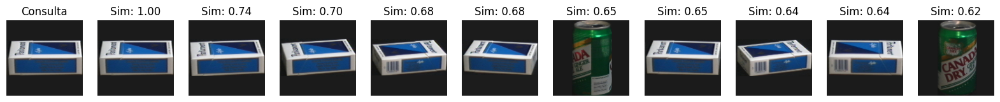

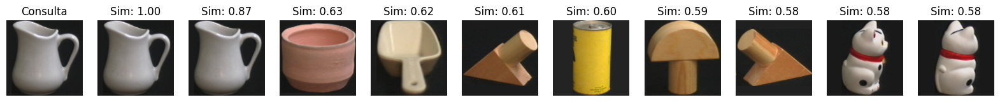

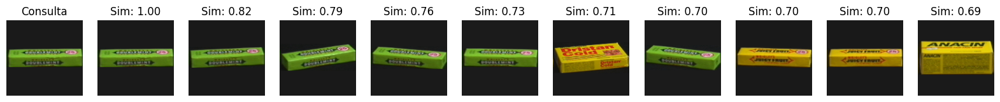

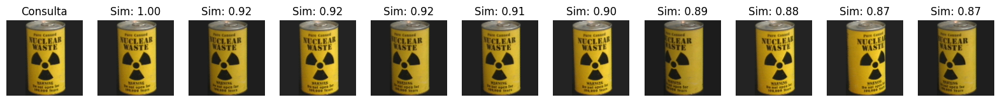

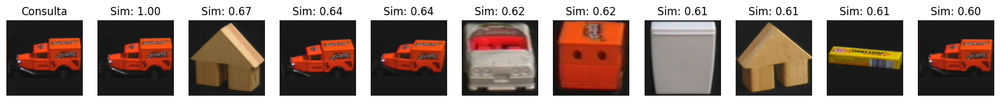

In [63]:
for obj in objs:
    consulta(obj=obj, total_consultas=10, figsize=(20,5))